In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import shutil
import cv2
import os
from tqdm import tqdm
import random

random.seed(42)

In [2]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.87 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.1/8062.4 GB disk)


In [3]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolo11s.yaml")

# Train the model
results = model.train(data="/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml", 
                      epochs=100,
                      patience=10,
                      imgsz=640,
                      pretrained=False,
                      device=0,
                      # batch=32,
                      # optimizer='AdamW',
                      # lr0=0.001,
                      # momentum=0.9,
                      )

Ultralytics 8.3.87 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.yaml, data=/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml, epochs=100, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=T

100%|██████████| 755k/755k [00:00<00:00, 16.5MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  1    346112  ultralytics.nn.modules.block.C3k2            [256, 256, 1, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 68.3MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/train/labels... 1740 images, 442 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:10<00:00, 169.42it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/val/labels... 217 images, 55 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:01<00:00, 198.94it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/val is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      4.06G      3.501      5.855      3.855         14        640: 100%|██████████| 109/109 [00:31<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]


                   all        217        163   0.000278      0.121   0.000206   6.85e-05

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      4.83G      2.763      4.255      2.995         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.93it/s]

                   all        217        163      0.439       0.16     0.0643     0.0178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      4.85G      2.506      3.311       2.68         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.81it/s]


                   all        217        163      0.537      0.331      0.209     0.0757

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      4.85G      2.372      2.855      2.543          8        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.229      0.118     0.0525     0.0182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      4.85G      2.232      2.453      2.418         22        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.354      0.374      0.317       0.13



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      4.85G      2.139      2.273      2.368         20        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]


                   all        217        163      0.215      0.297      0.172     0.0637

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      4.85G      2.089      2.154      2.299         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.78it/s]


                   all        217        163      0.489      0.492      0.441      0.194

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      4.85G      2.073      2.026      2.292         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163       0.64       0.11      0.125     0.0495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      4.85G      2.011      1.939      2.258         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.569      0.558      0.574      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      4.85G      1.985      1.814      2.213         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        217        163      0.601       0.64      0.651      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      4.85G      1.976      1.826      2.221         18        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.92it/s]

                   all        217        163      0.653      0.543      0.618      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      4.85G      1.949      1.737      2.178         21        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.518      0.595      0.592      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      4.85G      1.911      1.751       2.15         10        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        217        163      0.665      0.595      0.635      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      4.85G      1.905      1.647      2.136         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        217        163      0.588      0.486      0.529      0.241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.85G      1.874      1.628      2.097         20        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        217        163      0.606      0.471      0.556      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      4.85G      1.877      1.612      2.111         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.98it/s]

                   all        217        163      0.605      0.551       0.55      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.85G      1.887      1.565       2.12         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]

                   all        217        163      0.648       0.67      0.695       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      4.85G      1.878      1.595        2.1         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.654      0.727      0.772      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.85G      1.812      1.503      2.034         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]


                   all        217        163      0.742      0.693       0.76      0.378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      4.85G      1.852      1.501      2.093         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]

                   all        217        163      0.635      0.713      0.732      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.85G      1.832      1.477      2.043         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.99it/s]

                   all        217        163      0.741      0.639      0.716      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      4.85G      1.781      1.445      2.014          7        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.98it/s]

                   all        217        163      0.777        0.7      0.769      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      4.85G      1.791      1.438      2.041         10        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        217        163      0.718      0.664        0.7      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      4.85G      1.783      1.417      2.018         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.768      0.671      0.744      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      4.85G      1.786      1.428      2.027         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        217        163      0.748      0.639      0.733      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      4.85G      1.771      1.379      2.017         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        217        163       0.73      0.683      0.757      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.85G       1.78      1.394      2.029         10        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        217        163      0.731      0.689      0.772      0.355



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      4.85G      1.747      1.343       1.96         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.92it/s]

                   all        217        163      0.714      0.746      0.793      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.85G      1.784      1.353      2.018         17        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.703      0.574      0.684      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      4.85G      1.761       1.35      1.977         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        217        163      0.833      0.705      0.812      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      4.85G      1.735      1.326      1.973         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.99it/s]

                   all        217        163       0.76      0.714      0.804        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      4.85G      1.761      1.345      1.985         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]


                   all        217        163      0.769      0.789      0.794      0.394

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.85G      1.722      1.303      1.943         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        217        163      0.749      0.728      0.803      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      4.85G      1.759      1.268      1.993         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.755      0.771      0.816      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.85G      1.707      1.268       1.94         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        217        163      0.775      0.772      0.815      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      4.85G      1.737      1.264      1.991         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.11it/s]

                   all        217        163      0.796      0.821       0.86      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.85G      1.732      1.247      1.938         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.778      0.756      0.793      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      4.85G      1.706      1.226      1.962         21        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]

                   all        217        163       0.75      0.754      0.765      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.85G      1.691       1.22      1.952          8        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.92it/s]

                   all        217        163      0.713      0.661      0.728      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      4.85G      1.703       1.19      1.933         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163      0.767      0.791       0.83      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.85G       1.66      1.162      1.903          6        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        217        163       0.83      0.734      0.825      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      4.85G      1.666      1.171      1.921         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.99it/s]

                   all        217        163      0.784      0.783      0.827      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.85G       1.66      1.149      1.902         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.99it/s]

                   all        217        163      0.828      0.808       0.85      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      4.85G      1.658      1.141      1.893         18        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        217        163      0.757       0.79      0.842      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.85G      1.672      1.167      1.923         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        217        163      0.728      0.793       0.84      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      4.85G      1.668      1.151      1.909         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.824      0.816      0.863      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.85G      1.675      1.151      1.941         17        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        217        163      0.816       0.77      0.849      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      4.85G      1.653      1.149      1.888         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        217        163      0.733      0.792      0.841      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      4.85G      1.634      1.111      1.869         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163      0.741       0.83       0.84      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      4.85G      1.605      1.076      1.854         20        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.09it/s]

                   all        217        163      0.822      0.817      0.859      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.85G      1.614      1.085       1.87         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        217        163       0.79      0.826      0.857       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      4.85G      1.603      1.065       1.85         19        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        217        163      0.843      0.788      0.863      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.85G      1.617      1.061      1.847          9        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        217        163        0.8      0.799      0.847       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      4.85G      1.592      1.066      1.863         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        217        163      0.843      0.789      0.852      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      4.85G       1.58      1.022      1.834         21        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163      0.818      0.835      0.887      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      4.85G      1.584      1.035      1.844         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.818      0.816      0.872      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      4.85G      1.578      1.017      1.839         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.13it/s]

                   all        217        163      0.822      0.675      0.807      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      4.85G      1.574       1.03      1.813         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        217        163      0.832       0.82      0.863      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      4.85G      1.578     0.9884       1.82         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        217        163      0.814      0.785      0.861      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      4.85G      1.594     0.9777      1.851         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.11it/s]

                   all        217        163      0.898      0.785      0.877      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      4.85G      1.562     0.9909      1.828         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.767      0.849      0.876      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      4.85G      1.531     0.9541      1.809         24        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]

                   all        217        163      0.824      0.864      0.895      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      4.85G      1.525     0.9693      1.796          8        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        217        163      0.868      0.822      0.873      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      4.85G      1.563      0.992      1.829         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        217        163      0.828       0.88       0.88      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      4.85G      1.557     0.9464      1.817         18        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        217        163      0.869      0.835      0.905      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      4.85G      1.554     0.9566       1.83         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        217        163      0.824      0.839      0.882      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      4.85G      1.523     0.9669       1.81         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        217        163      0.836      0.847      0.888      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      4.85G      1.557     0.9734      1.809         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.793      0.781      0.873      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      4.85G      1.512     0.9414      1.792          8        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.843      0.816      0.897      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      4.85G      1.507     0.9313      1.775         19        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.11it/s]

                   all        217        163      0.889      0.851      0.908       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      4.85G      1.531     0.9385      1.784         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.12it/s]

                   all        217        163      0.861      0.831      0.901      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      4.85G      1.505     0.9313      1.767         20        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163      0.861      0.856        0.9      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      4.85G      1.481     0.8893      1.758         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.14it/s]

                   all        217        163      0.885      0.803      0.891      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      4.85G      1.479     0.9175      1.749         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        217        163      0.863      0.834      0.882      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      4.85G      1.494     0.9076      1.766         18        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        217        163      0.815      0.852       0.89      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      4.85G      1.467     0.8746      1.734         23        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        217        163      0.893      0.797      0.878      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      4.85G      1.459     0.8684      1.727         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        217        163      0.819      0.841      0.873       0.48
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 67, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



77 epochs completed in 0.682 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 19.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 19.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.87 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,413,961 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.97it/s]


                   all        217        163      0.836      0.847      0.889      0.487
             pituitary         62         63      0.908      0.905      0.938       0.49
            meningioma         55         55       0.94      0.859      0.964      0.571
                glioma         45         45      0.659      0.778      0.764        0.4


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 4.9ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/train


In [4]:
val_results = model.val(split='test')

Ultralytics 8.3.87 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,413,961 parameters, 0 gradients, 21.3 GFLOPs


val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/test/labels... 218 images, 55 backgrounds, 0 corrupt: 100%|██████████| 218/218 [00:01<00:00, 181.32it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  4.17it/s]


                   all        218        164       0.92       0.84      0.907      0.485
             pituitary         62         62      0.967       0.94       0.99      0.459
            meningioma         55         55      0.991      0.891      0.989      0.615
                glioma         46         47      0.802       0.69      0.743      0.381


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 1.4ms preprocess, 9.3ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train2


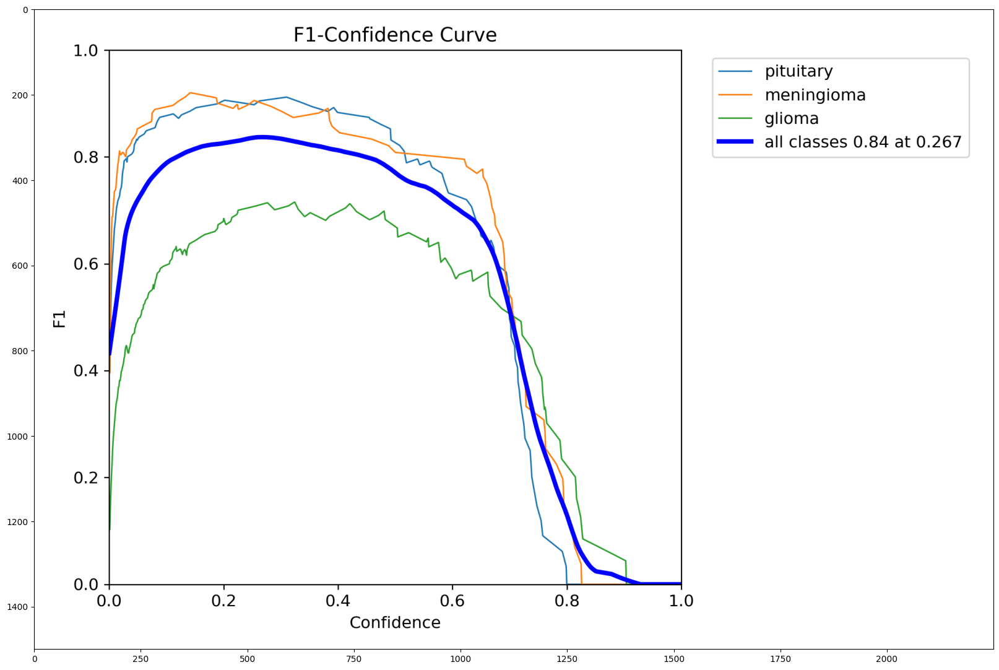

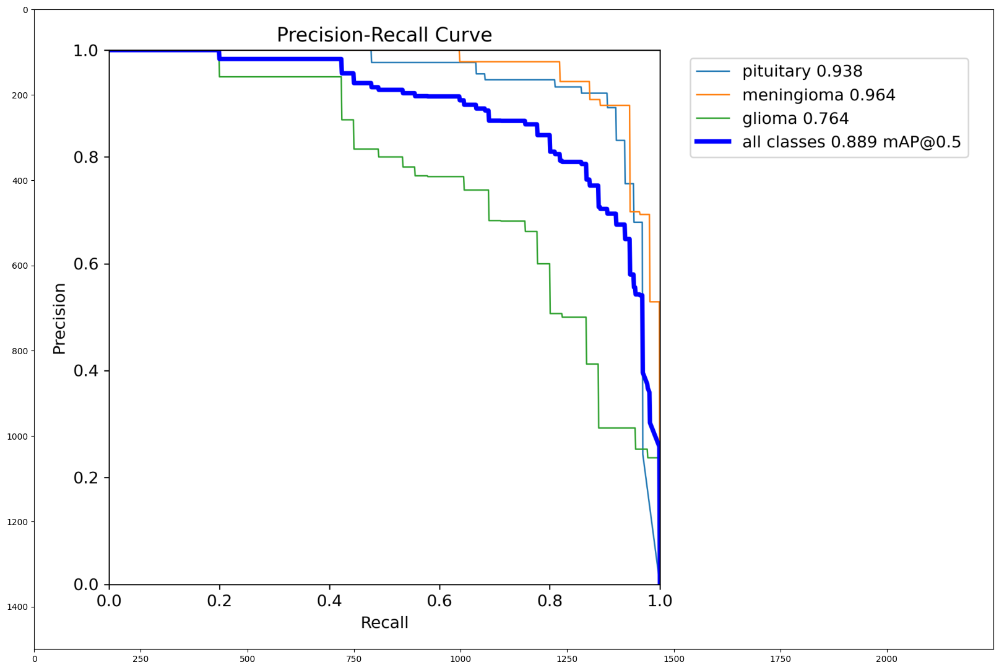

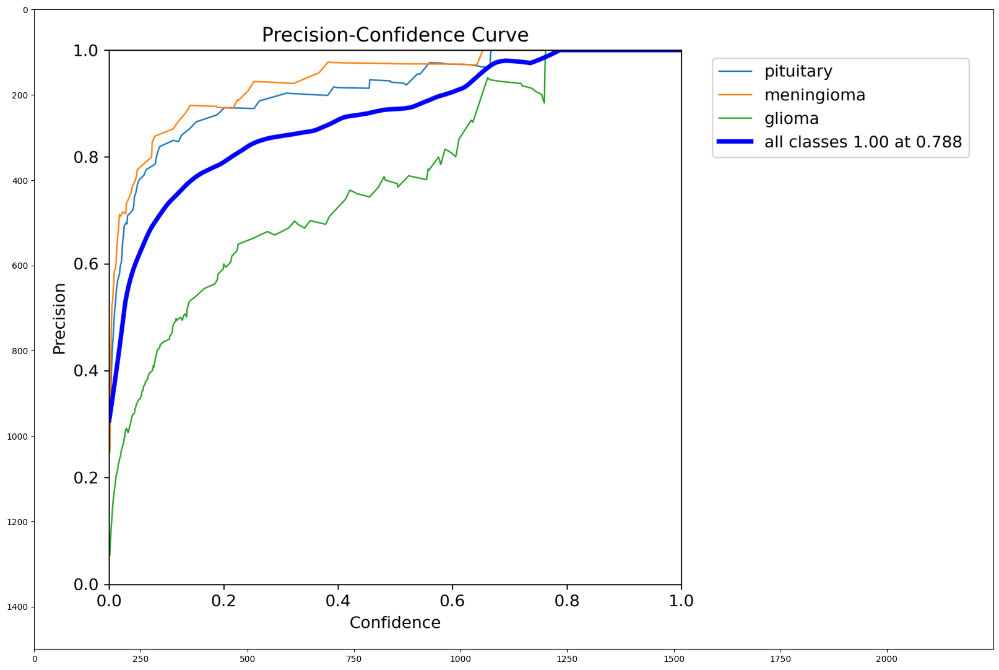

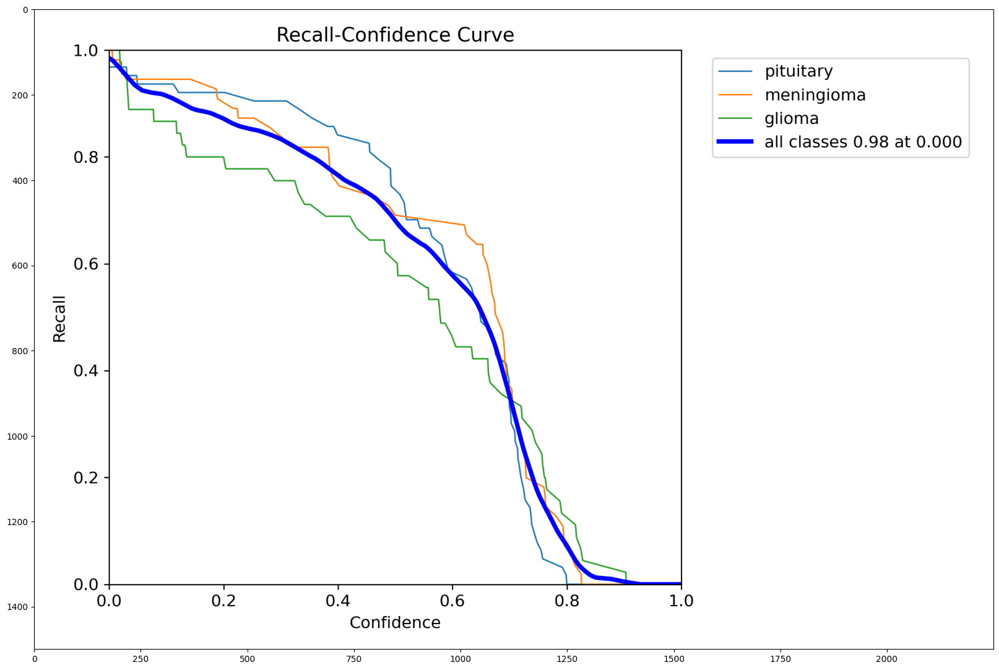

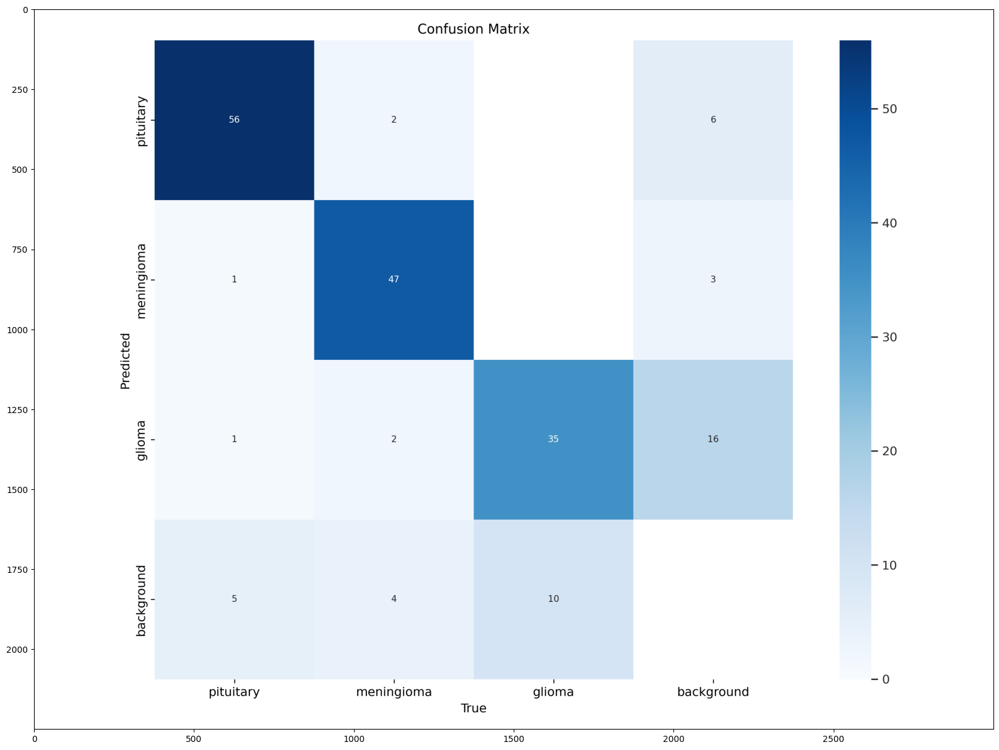

...

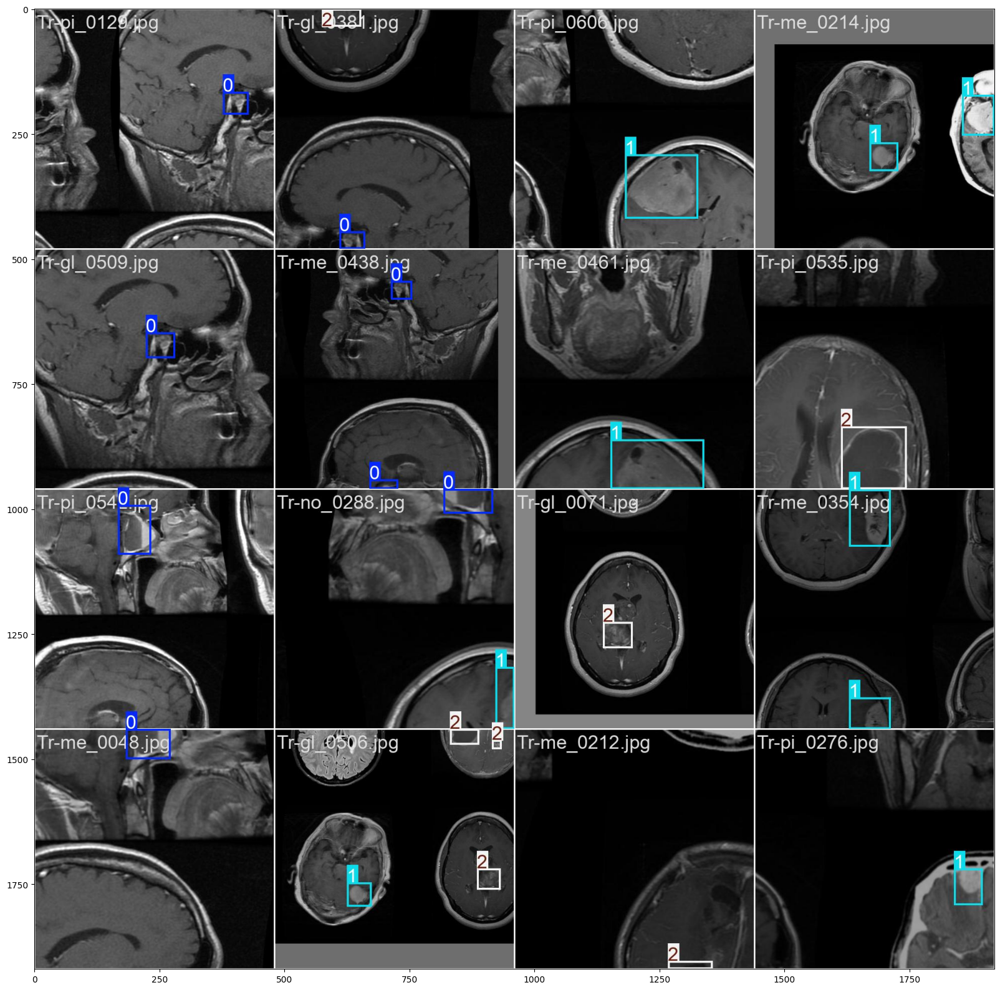

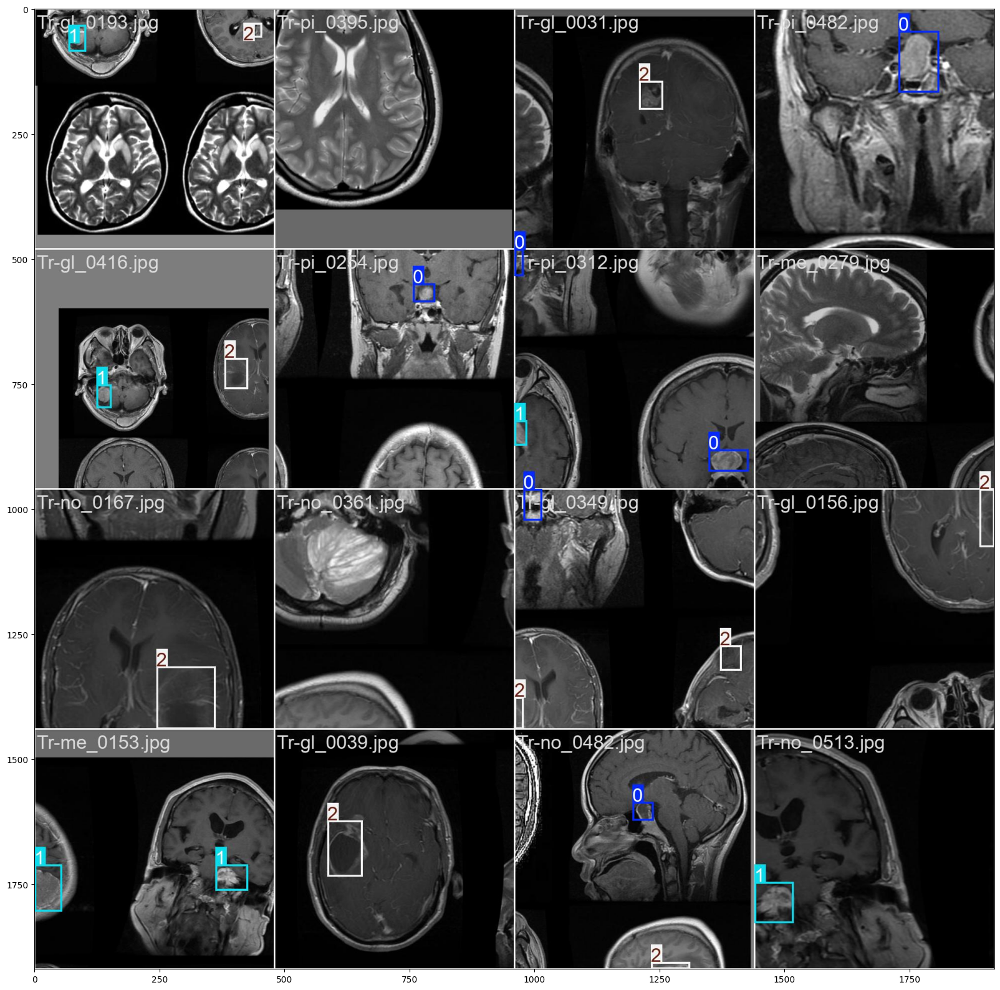

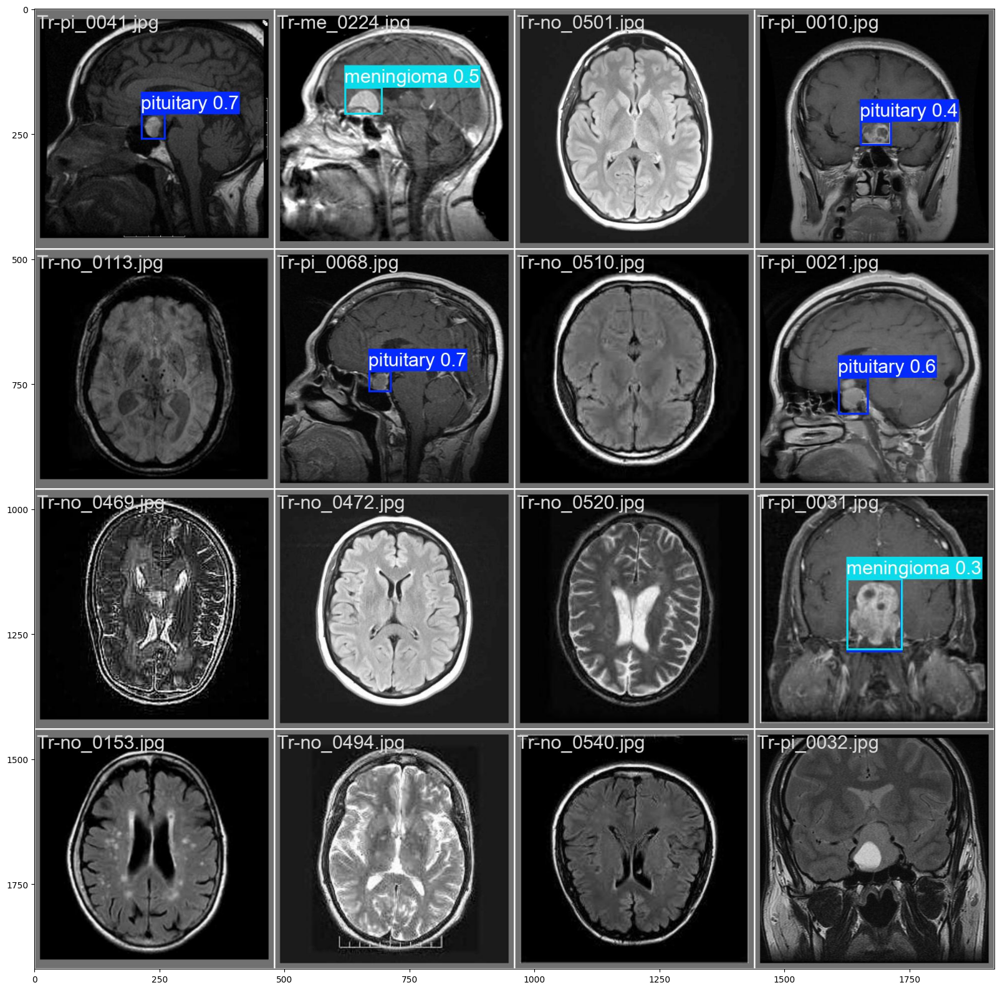

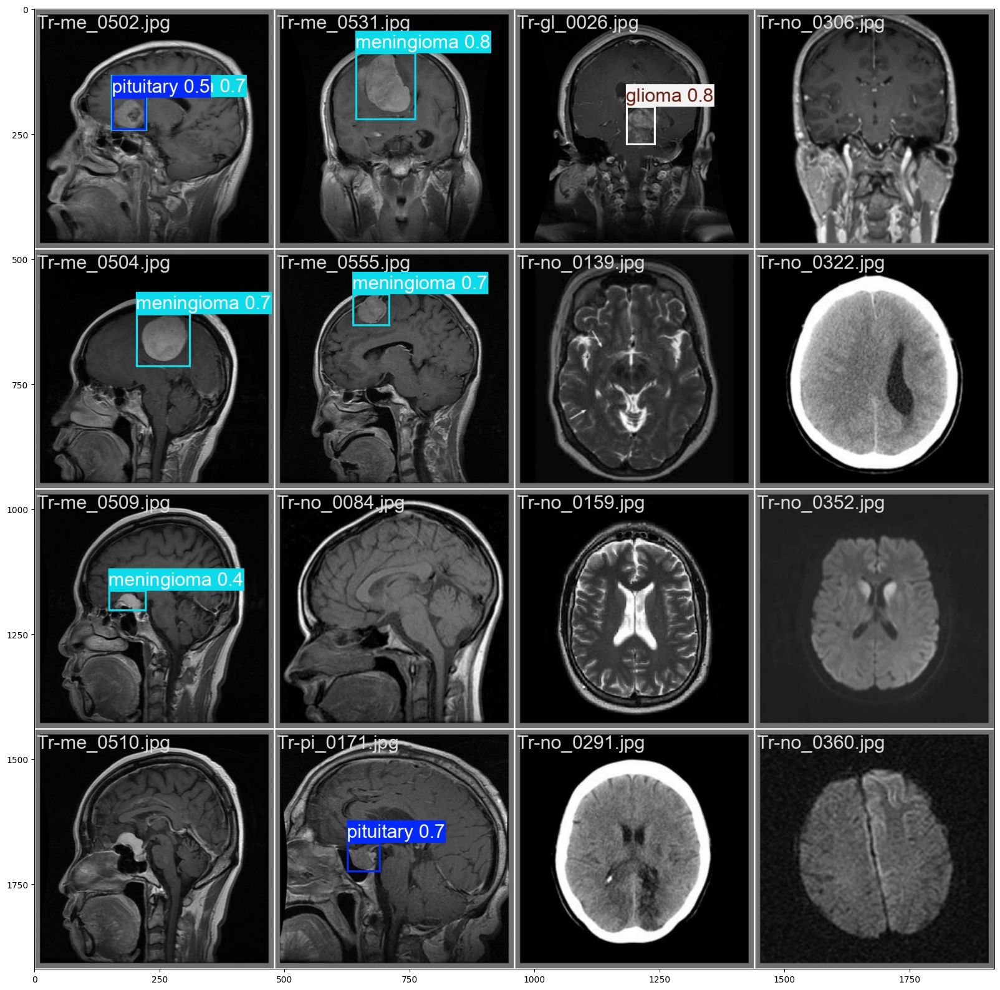

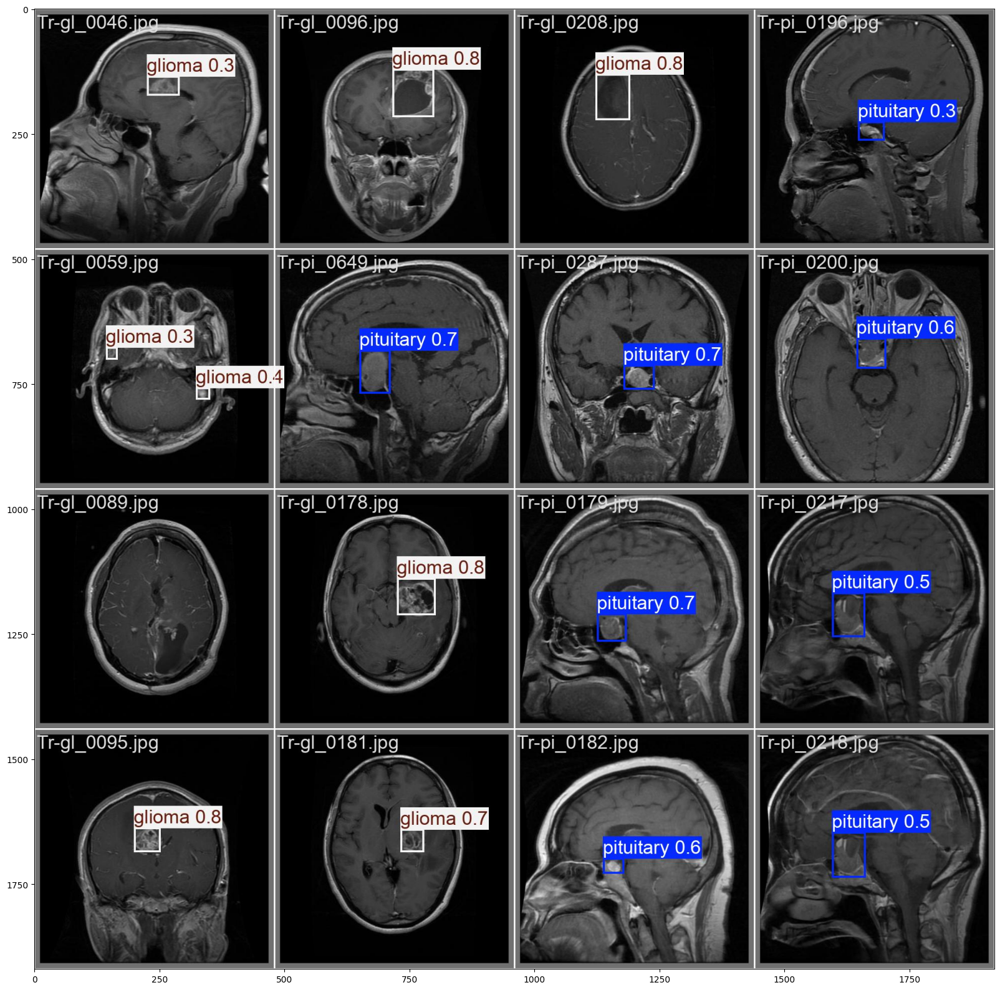

In [5]:
for path in sorted(glob.glob('/kaggle/working/runs/detect/train/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/runs/detect/train/*.jpg')):
    if not path.split('.')[0].endswith('_labels') or path.split('.')[0].startswith('train_'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()

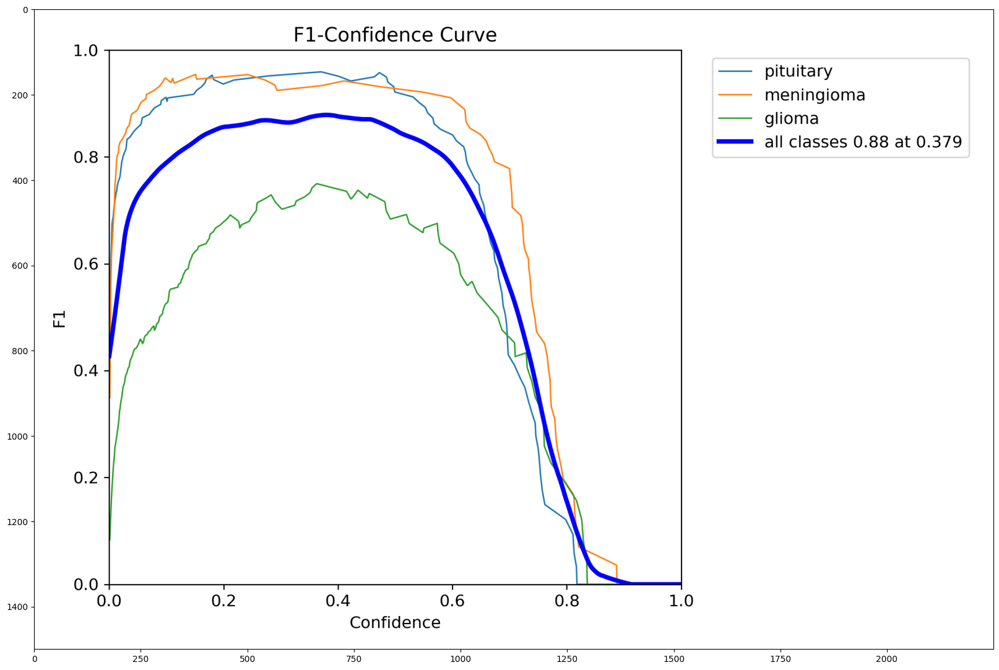

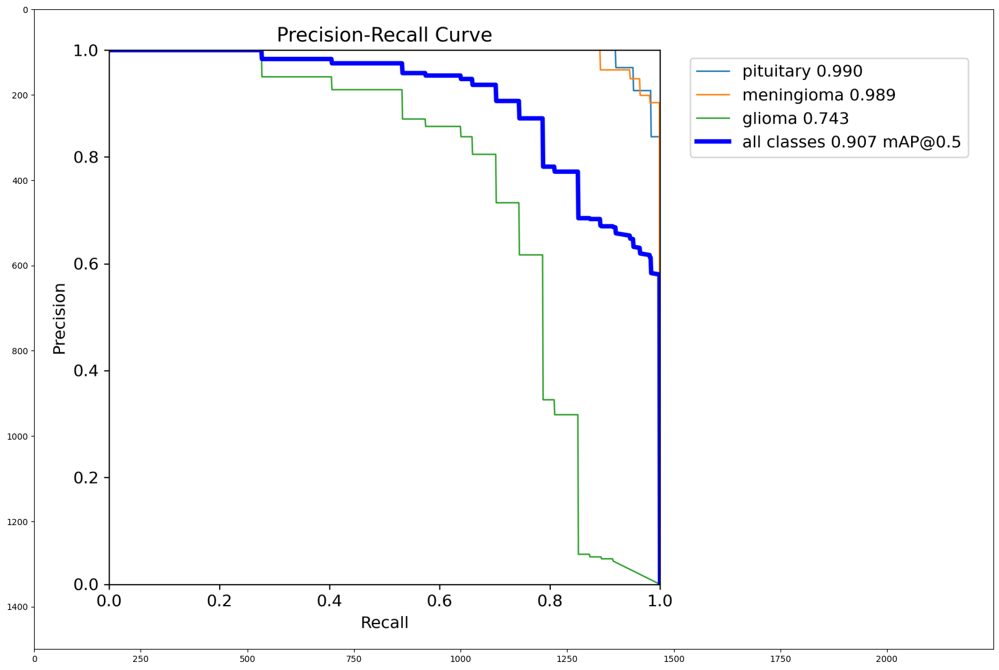

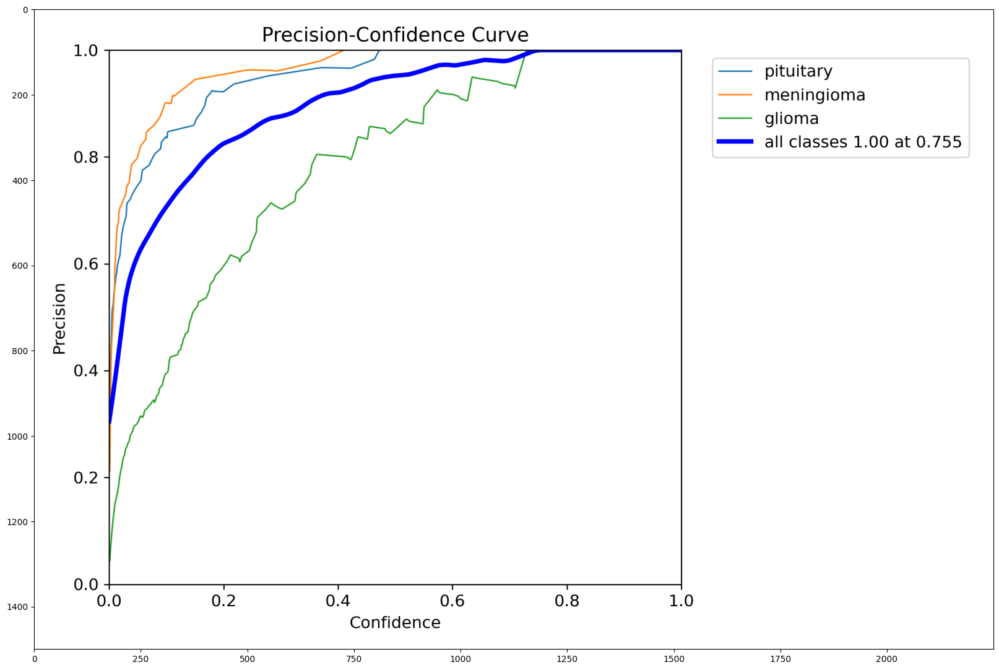

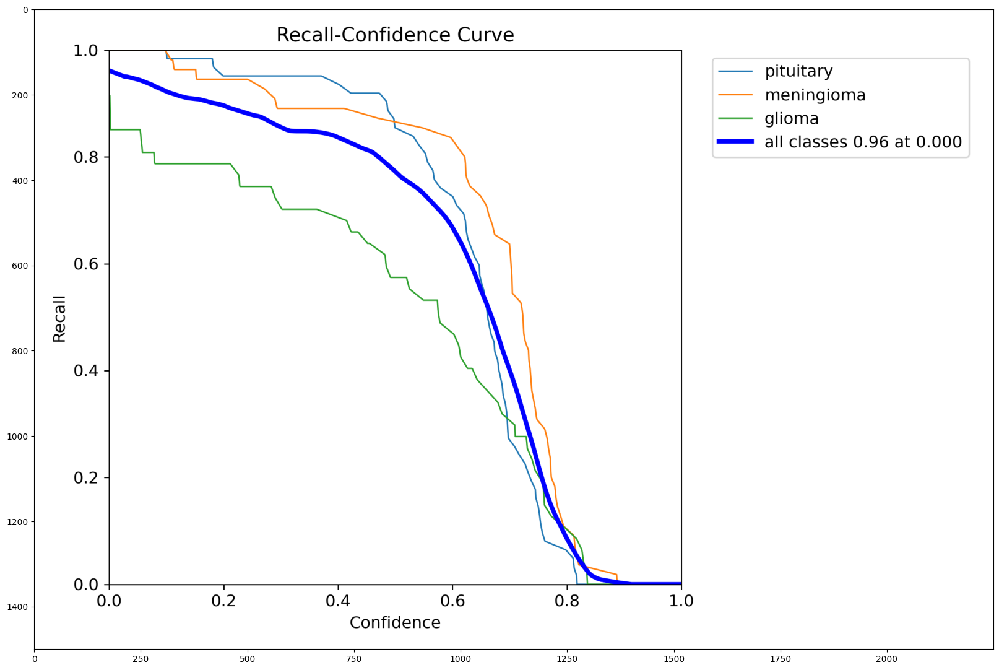

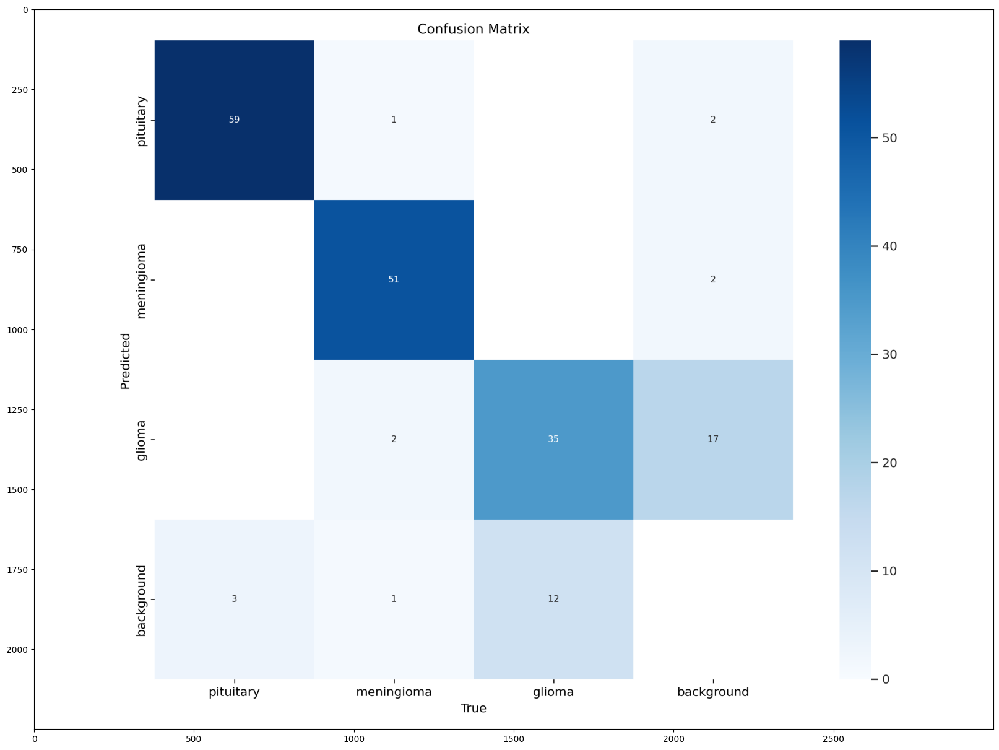

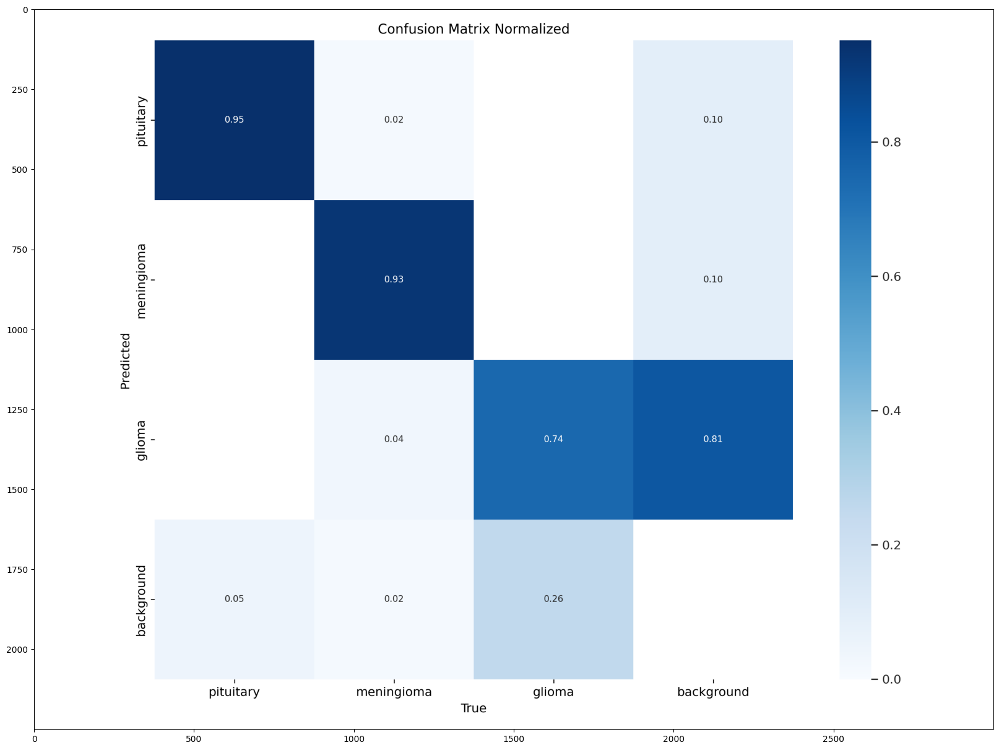

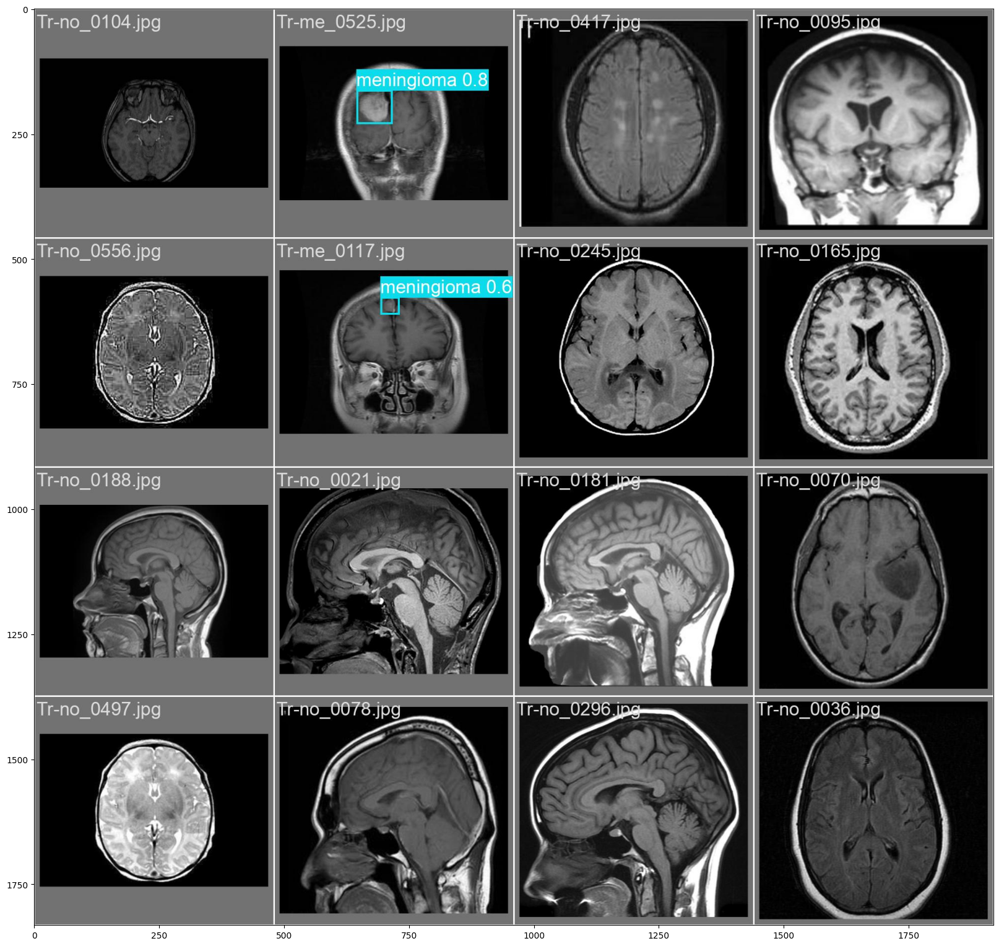

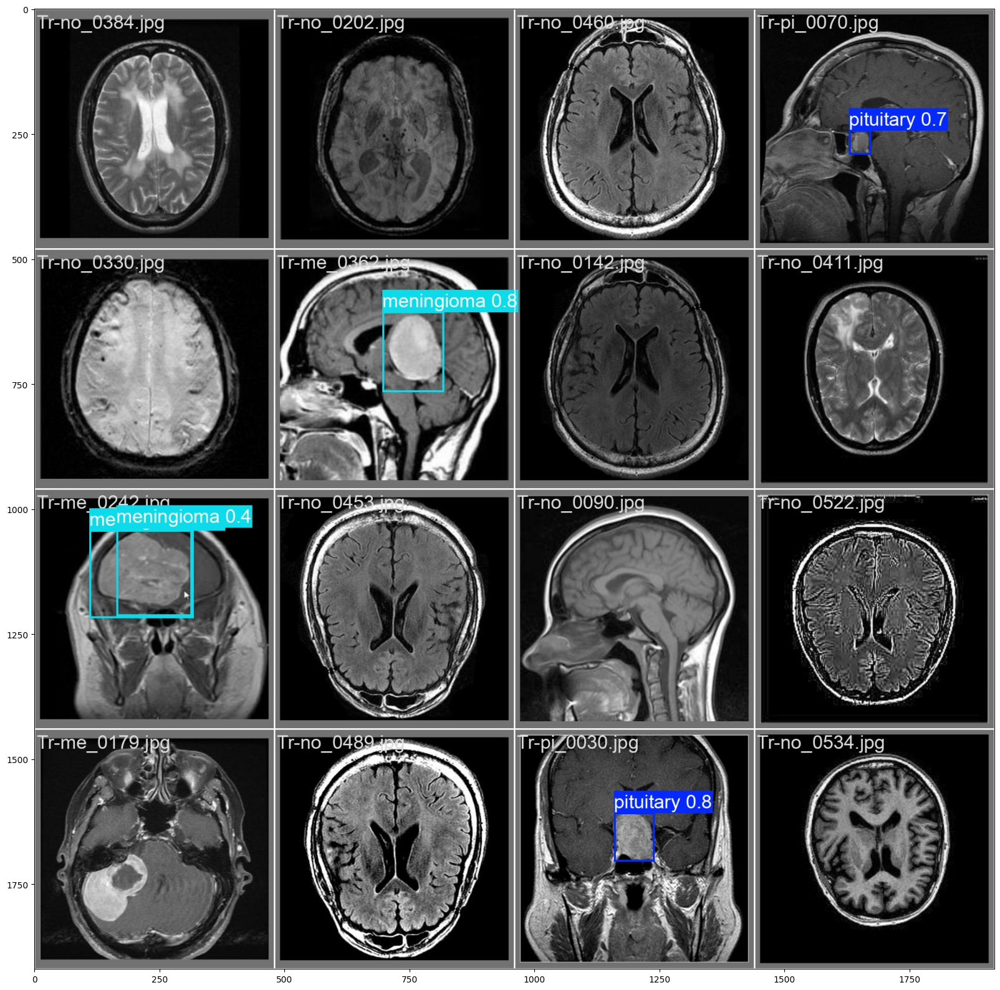

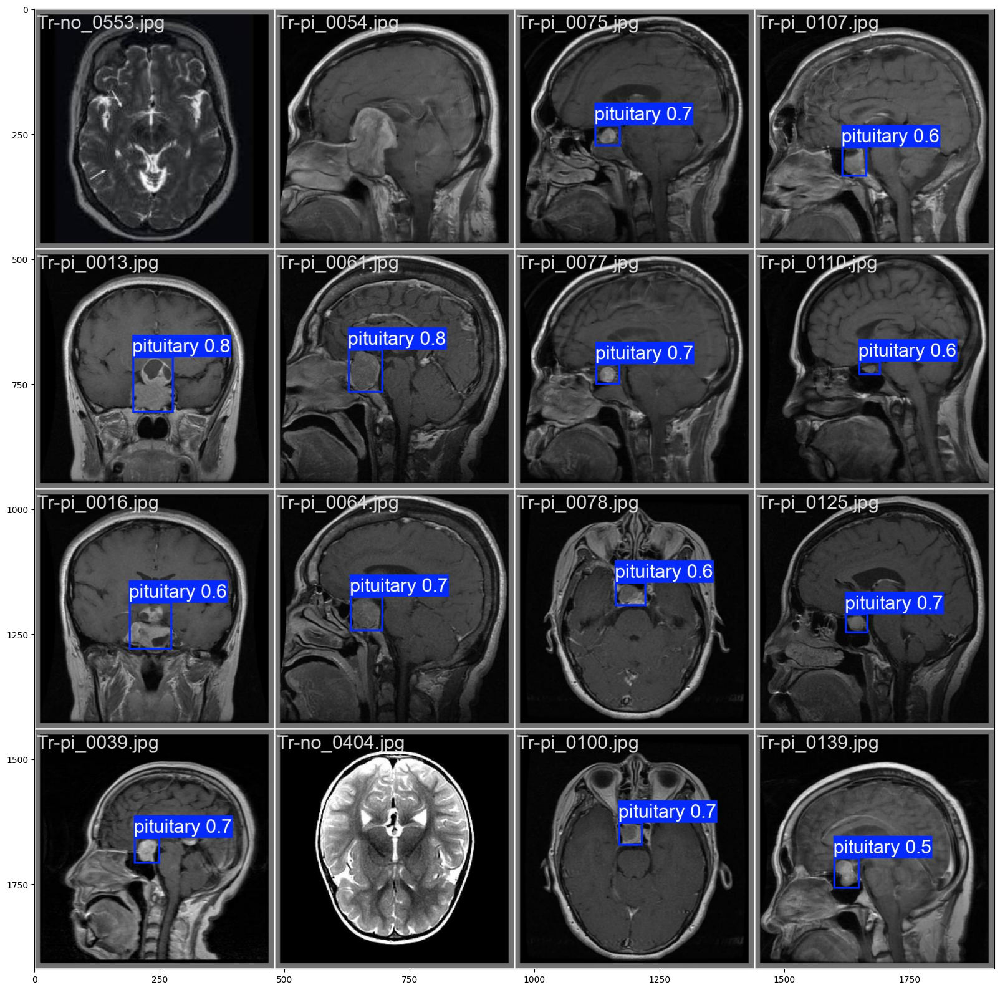

In [6]:
for path in sorted(glob.glob('/kaggle/working/runs/detect/train2/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/runs/detect/train2/*.jpg')):
    if not path.split('.')[0].endswith('_labels'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()